Sources:
- https://www.kaggle.com/code/leonidkulyk/eda-aslfr-animated-visualization
- https://www.nidcd.nih.gov/health/american-sign-language#:~:text=American%20Sign%20Language%20(ASL)%20is,of%20the%20hands%20and%20face.
- https://en.wikipedia.org/wiki/American_Sign_Language
- https://www.kaggle.com/code/markwijkhuizen/aslfr-eda-preprocessing-dataset

### What is American sign language (ASL)

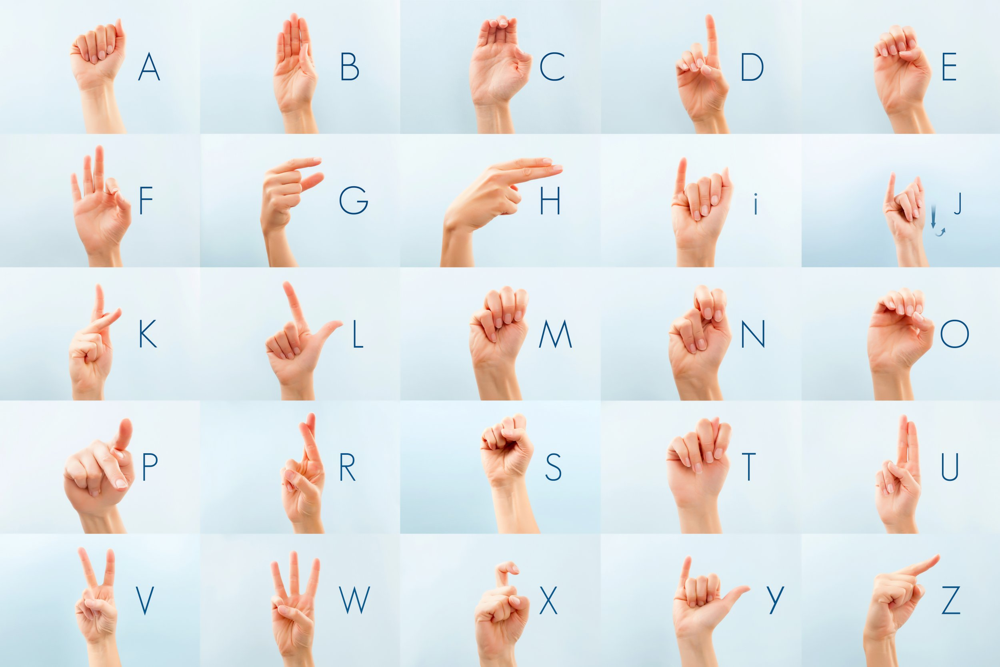

**What is American Sign Language?**

American Sign Language (ASL) is a complete, natural language that has the same linguistic properties as spoken languages, with grammar that differs from English. ASL is expressed by movements of the hands and face. It is the primary language of many North Americans who are deaf and hard of hearing and is used by some hearing people as well.

**Is sign language the same in other countries?**

There is no universal sign language. Different sign languages are used in different countries or regions. For example, British Sign Language (BSL) is a different language from ASL, and Americans who know ASL may not understand BSL. Some countries adopt features of ASL in their sign languages.

**Where did ASL originate?**

No person or committee invented ASL. The exact beginnings of ASL are not clear, but some suggest that it arose more than 200 years ago from the intermixing of local sign languages and French Sign Language (LSF, or Langue des Signes Française). Today’s ASL includes some elements of LSF plus the original local sign languages; over time, these have melded and changed into a rich, complex, and mature language. Modern ASL and modern LSF are distinct languages. While they still contain some similar signs, they can no longer be understood by each other’s users.

**How does ASL compare with spoken language?**

ASL is a language completely separate and distinct from English. It contains all the fundamental features of language, with its own rules for pronunciation, word formation, and word order. While every language has ways of signaling different functions, such as asking a question rather than making a statement, languages differ in how this is done. For example, English speakers may ask a question by raising the pitch of their voices and by adjusting word order; ASL users ask a question by raising their eyebrows, widening their eyes, and tilting their bodies forward.

Just as with other languages, specific ways of expressing ideas in ASL vary as much as ASL users themselves. In addition to individual differences in expression, ASL has regional accents and dialects; just as certain English words are spoken differently in different parts of the country, ASL has regional variations in the rhythm of signing, pronunciation, slang, and signs used. Other sociological factors, including age and gender, can affect ASL usage and contribute to its variety, just as with spoken languages.

Fingerspelling is part of ASL and is used to spell out English words. In the fingerspelled alphabet, each letter corresponds to a distinct handshape. Fingerspelling is often used for proper names or to indicate the English word for something.



### Dataset Description

The goal of this competition is to detect and translate American Sign Language (ASL) fingerspelling into text.

This competition requires submissions to be made in the form of TensorFlow Lite models. You are welcome to train your model using the framework of your choice as long as you convert the model checkpoint into the tflite format prior to submission. Please see the evaluation page for details.

#### Files
```[train/supplemental_metadata].csv```

path - The path to the landmark file.

file_id - A unique identifier for the data file.

participant_id - A unique identifier for the data contributor.

sequence_id - A unique identifier for the landmark sequence. Each data file may contain many sequences.

phrase - The labels for the landmark sequence. The train and test datasets contain randomly generated addresses, phone numbers, and urls derived from components of real addresses/phone numbers/urls. Any overlap with real addresses, phone numbers, or urls is purely accidental. The supplemental dataset consists of fingerspelled sentences. Note that some of the urls include adult content. The intent of this competition is to support the Deaf and Hard of Hearing community in engaging with technology on an equal footing with other adults.

```character_to_prediction_index.json```

[train/supplemental]_landmarks/ The landmark data. The landmarks were extracted from raw videos with the MediaPipe holistic model. Not all of the frames necessarily had visible hands or hands that could be detected by the model.

The landmark files contain the same data as in the ASL Signs competition (minus the row ID column) but reshaped into a wide format. This allows you to take advantage of the Parquet format to entirely skip loading landmarks that you aren't using.

sequence_id - A unique identifier for the landmark sequence. landmark files contain approximately 1,000 sequences. The sequence ID is used as the dataframe index.
frame - The frame number within a landmark sequence.

[x/y/z]_[type]_[landmark_index] - There are now 1,629 spatial coordinate columns for the x, y and z coordinates for each of the 543 landmarks. The type of landmark is one of ['face', 'left_hand', 'pose', 'right_hand']. Details of the hand landmark locations can be found here. The spatial coordinates have already been normalized by MediaPipe. Note that the MediaPipe model is not fully trained to predict depth so you may wish to ignore the z values. The landmarks have been converted to float32.

Landmark data should not be used to identify or re-identify an individual. Landmark data is not intended to enable any form of identity recognition or store any unique biometric identification.

### Imports / Utils

In [61]:
import numpy as np
import pandas as pd
import json
import plotly.graph_objects as go
import plotly.io as pio
import re
import matplotlib.pyplot as plt
import math
import tensorflow as tf
import gc

from pathlib import Path
from tqdm import tqdm
from sklearn.model_selection import train_test_split, GroupShuffleSplit


In [3]:
# Data utils
def map_new_to_old_style(sequence):
    types = []
    landmark_indexes = []
    for column in list(sequence.columns)[1:544]:
        parts = column.split("_")
        if len(parts) == 4:
            types.append(parts[1] + "_" + parts[2])
        else:
            types.append(parts[1])

        landmark_indexes.append(int(parts[-1]))

    data = {
        "frame": [],
        "type": [],
        "landmark_index": [],
        "x": [],
        "y": [],
        "z": []
    }

    for index, row in sequence.iterrows():
        data["frame"] += [int(row.frame)]*543
        data["type"] += types
        data["landmark_index"] += landmark_indexes

        for _type, landmark_index in zip(types, landmark_indexes):
            data["x"].append(row[f"x_{_type}_{landmark_index}"])
            data["y"].append(row[f"y_{_type}_{landmark_index}"])
            data["z"].append(row[f"z_{_type}_{landmark_index}"])

    return pd.DataFrame.from_dict(data)

# assign desired colors to landmarks
def assign_color(row):
    if row == 'face':
        return 'red'
    elif 'hand' in row:
        return 'dodgerblue'
    else:
        return 'green'

# specifies the plotting order
def assign_order(row):
    if row.type == 'face':
        return row.landmark_index + 101
    elif row.type == 'pose':
        return row.landmark_index + 30
    elif row.type == 'left_hand':
        return row.landmark_index + 80
    else:
        return row.landmark_index

def visualise2d_landmarks(parquet_df, title=""):
    connections = [  
        [0, 1, 2, 3, 4,],
        [0, 5, 6, 7, 8],
        [0, 9, 10, 11, 12],
        [0, 13, 14, 15, 16],
        [0, 17, 18, 19, 20],

        
        [38, 36, 35, 34, 30, 31, 32, 33, 37],
        [40, 39],
        [52, 46, 50, 48, 46, 44, 42, 41, 43, 45, 47, 49, 45, 51],
        [42, 54, 56, 58, 60, 62, 58],
        [41, 53, 55, 57, 59, 61, 57],
        [54, 53],

        
        [80, 81, 82, 83, 84, ],
        [80, 85, 86, 87, 88],
        [80, 89, 90, 91, 92],
        [80, 93, 94, 95, 96],
        [80, 97, 98, 99, 100], ]

    parquet_df = map_new_to_old_style(parquet_df)
    frames = sorted(set(parquet_df.frame))
    first_frame = min(frames)
    parquet_df['color'] = parquet_df.type.apply(lambda row: assign_color(row))
    parquet_df['plot_order'] = parquet_df.apply(lambda row: assign_order(row), axis=1)
    first_frame_df = parquet_df[parquet_df.frame == first_frame].copy()
    first_frame_df = first_frame_df.sort_values(["plot_order"]).set_index('plot_order')


    frames_l = []
    for frame in frames:
        filtered_df = parquet_df[parquet_df.frame == frame].copy()
        filtered_df = filtered_df.sort_values(["plot_order"]).set_index("plot_order")
        traces = [go.Scatter(
            x=filtered_df['x'],
            y=filtered_df['y'],
            mode='markers',
            marker=dict(
                color=filtered_df.color,
                size=9))]

        for i, seg in enumerate(connections):
            trace = go.Scatter(
                    x=filtered_df.loc[seg]['x'],
                    y=filtered_df.loc[seg]['y'],
                    mode='lines',
            )
            traces.append(trace)
        frame_data = go.Frame(data=traces, traces = [i for i in range(17)])
        frames_l.append(frame_data)

    traces = [go.Scatter(
        x=first_frame_df['x'],
        y=first_frame_df['y'],
        mode='markers',
        marker=dict(
            color=first_frame_df.color,
            size=9
        )
    )]
    for i, seg in enumerate(connections):
        trace = go.Scatter(
            x=first_frame_df.loc[seg]['x'],
            y=first_frame_df.loc[seg]['y'],
            mode='lines',
            line=dict(
                color='black',
                width=2
            )
        )
        traces.append(trace)
    fig = go.Figure(
        data=traces,
        frames=frames_l
    )


    fig.update_layout(
        width=500,
        height=800,
        scene={
            'aspectmode': 'data',
        },
        updatemenus=[
            {
                "buttons": [
                    {
                        "args": [None, {"frame": {"duration": 100,
                                                  "redraw": True},
                                        "fromcurrent": True,
                                        "transition": {"duration": 0}}],
                        "label": "&#9654;",
                        "method": "animate",
                    },

                ],
                "direction": "left",
                "pad": {"r": 100, "t": 100},
                "font": {"size":30},
                "type": "buttons",
                "x": 0.1,
                "y": 0,
            }
        ],
    )
    camera = dict(
        up=dict(x=0, y=-1, z=0),
        eye=dict(x=0, y=0, z=2.5)
    )
    fig.update_layout(title_text=title, title_x=0.5)
    fig.update_layout(scene_camera=camera, showlegend=False)
    fig.update_layout(xaxis = dict(visible=False),
            yaxis = dict(visible=False),
    )
    fig.update_yaxes(autorange="reversed")

    fig.show()


def get_phrase(df, file_id, sequence_id):
    return df[
        np.logical_and(
            df.file_id == file_id, 
            df.sequence_id == sequence_id
        )
    ].phrase.iloc[0]

def get_phrase_type(phrase):
    # Phone Number
    if re.match(r'^[\d+-]+$', phrase):
        return 'phone_number'
    # url
    elif any([substr in phrase for substr in ['www', '.', '/']]) and ' ' not in phrase:
        return 'url'
    # Address
    else:
        return 'address'
    

def get_file_path(path):
    return f'asl-fingerspelling/{path}'

def get_idxs(df, words_pos, words_neg=[], ret_names=True, idxs_pos=None):
    idxs = []
    names = []
    for w in words_pos:
        for col_idx, col in enumerate(df.columns):
            # Exclude Non Landmark Columns
            if col in ['frame']:
                continue
                
            col_idx = int(col.split('_')[-1])
            # Check if column name contains all words
            if (w in col) and (idxs_pos is None or col_idx in idxs_pos) and all([w not in col for w in words_neg]):
                idxs.append(col_idx)
                names.append(col)
    # Convert to Numpy arrays
    idxs = np.array(idxs)
    names = np.array(names)
    # Returns either both column indices and names
    if ret_names:
        return idxs, names
    # Or only columns indices
    else:
        return idxs

### MediaPipe holistic model

[MediaPipe Holistic Solution](https://github.com/google/mediapipe/blob/master/docs/solutions/holistic.md): Live perception of simultaneous human pose, face landmarks, and hand tracking in real-time on mobile devices can enable various modern life applications: fitness and sport analysis, gesture control and sign language recognition, augmented reality try-on and effects. MediaPipe already offers fast and accurate, yet separate, solutions for these tasks. Combining them all in real-time into a semantically consistent end-to-end solution is a uniquely difficult problem requiring simultaneous inference of multiple, dependent neural networks.

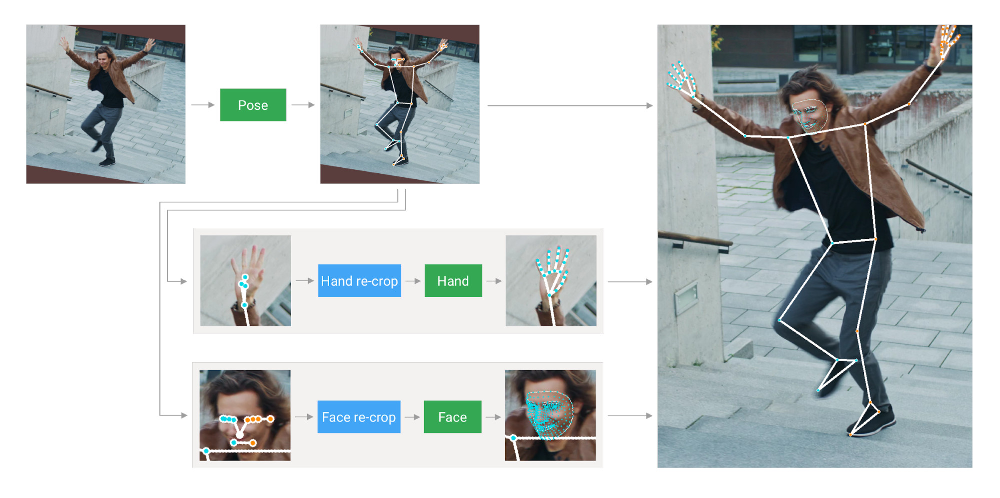
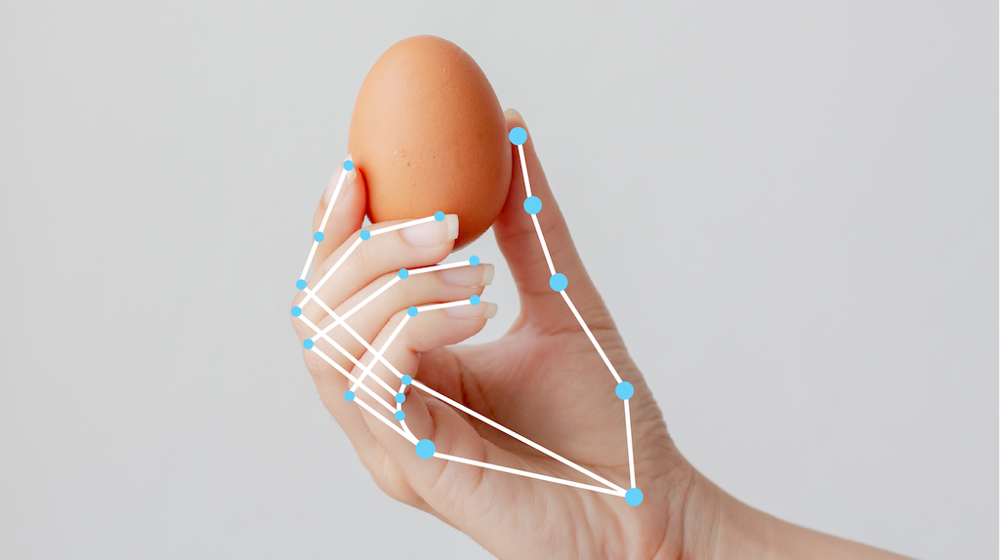
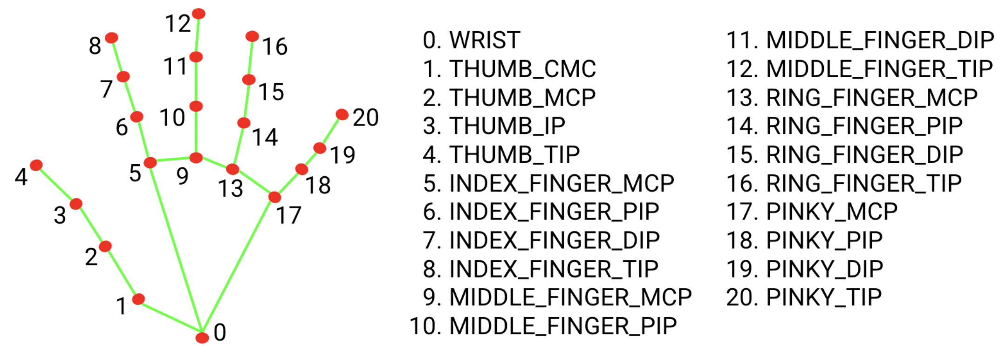

- Real time
- Open source
- SOTA
- Unified topology 
- Destop or mobile
- Separate ML models for separate tasks to match working resolutions
- Model Coordination and independance (ie modularity)

### Dataset look around

Taking a look at the csv to navigate the data

In [4]:
train_df = pd.read_csv("asl-fingerspelling/train.csv")
train_df.head()

,path,file_id,sequence_id,participant_id,phrase
0,train_landmarks/5414471.parquet,5414471,1816796431,217,3 creekhouse
1,train_landmarks/5414471.parquet,5414471,1816825349,107,scales/kuhaylah
2,train_landmarks/5414471.parquet,5414471,1816909464,1,1383 william lanier
3,train_landmarks/5414471.parquet,5414471,1816967051,63,988 franklin lane
4,train_landmarks/5414471.parquet,5414471,1817123330,89,6920 northeast 661st road


In [5]:
train_df.describe()

,file_id,sequence_id,participant_id
count,6.720800e+04,6.720800e+04,67208.000000
mean,1.094448e+09,1.072696e+09,119.758154
std,6.395616e+08,6.177372e+08,74.330468
min,5.414471e+06,7.109500e+04,0.000000
25%,5.277082e+08,5.376519e+08,63.000000
50%,1.099408e+09,1.074387e+09,113.000000
75%,1.662743e+09,1.605592e+09,178.000000
max,2.118949e+09,2.147465e+09,254.000000


Taking a look at the first row related data:

In [6]:
sequence_id = 1816796431
file_id = 5414471

path_to_sign = f"asl-fingerspelling/train_landmarks/{file_id}.parquet"
sign = pd.read_parquet(path_to_sign)

sign.head()

,frame,x_face_0,x_face_1,x_face_2,x_face_3,x_face_4,x_face_5,x_face_6,x_face_7,x_face_8,...,z_right_hand_11,z_right_hand_12,z_right_hand_13,z_right_hand_14,z_right_hand_15,z_right_hand_16,z_right_hand_17,z_right_hand_18,z_right_hand_19,z_right_hand_20
sequence_id,,,,,,,,,,,,,,,,,,,,,
1816796431,0,0.710588,0.699951,0.705657,0.691768,0.699669,0.701980,0.709724,0.610405,0.712660,...,-0.245855,-0.269148,-0.129743,-0.251501,-0.278687,-0.266530,-0.152852,-0.257519,-0.275822,-0.266876
1816796431,1,0.709525,0.697582,0.703713,0.691016,0.697576,0.700467,0.709796,0.616540,0.713729,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1816796431,2,0.711059,0.700858,0.706272,0.693285,0.700825,0.703319,0.711549,0.615606,0.715143,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1816796431,3,0.712799,0.702518,0.707840,0.694899,0.702445,0.704794,0.712483,0.625044,0.715677,...,-0.370770,-0.408097,-0.185217,-0.325494,-0.343373,-0.328294,-0.203126,-0.315719,-0.326104,-0.314282
1816796431,4,0.712349,0.705451,0.709918,0.696006,0.705180,0.706928,0.712685,0.614356,0.714875,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
number_of_sequence = len(np.unique(sign.index))
print(f'A parquet file contain {number_of_sequence} unique sequence.')



A parquet file contain 1000 unique sequence.


In [8]:
sequence_filter = sign[sign.index == sequence_id]
print(f' Number of frames in the selected sequence: {len(sequence_filter)} ')


 Number of frames in the selected sequence: 123 


Visualize the selected sequence:

In [9]:
sequence_phrase = get_phrase(train_df, file_id, sequence_id)
visualise2d_landmarks(sequence_filter, f"Phrase: {sequence_phrase}")

### Data stats

In [43]:
PERCENTILES = [0.01, 0.10, 0.05, 0.25, 0.50, 0.75, 0.90, 0.95, 0.99, 0.999]
IS_INTERACTIVE = False
FAST = False
SEED = 42
N_TARGET_FRAMES = 128
N_SAMPLES = len(train_df)


#### Phrases

In [28]:
train_df['phrase_type'] = train_df['phrase'].apply(get_phrase_type)

train_df['file_path'] = train_df['path'].apply(get_file_path)

In [29]:
# Split Phrase To Char Tuple
train_df['phrase_char'] = train_df['phrase'].apply(tuple)
# Character Length of Phrase
train_df['phrase_char_len'] = train_df['phrase_char'].apply(len)

# Maximum Input Length
MAX_PHRASE_LENGTH = train_df['phrase_char_len'].max()
print(f'MAX_PHRASE_LENGTH: {MAX_PHRASE_LENGTH}')

# Train DataFrame indexed by sequence_id to convenientlyy lookup recording data
train_sequence_id = train_df.set_index('sequence_id')

MAX_PHRASE_LENGTH: 31


,phrase_char_len
count,67208.0
mean,17.8
std,5.7
min,1.0
1%,8.0
5%,11.0
10%,12.0
25%,12.0
50%,17.0
75%,22.0


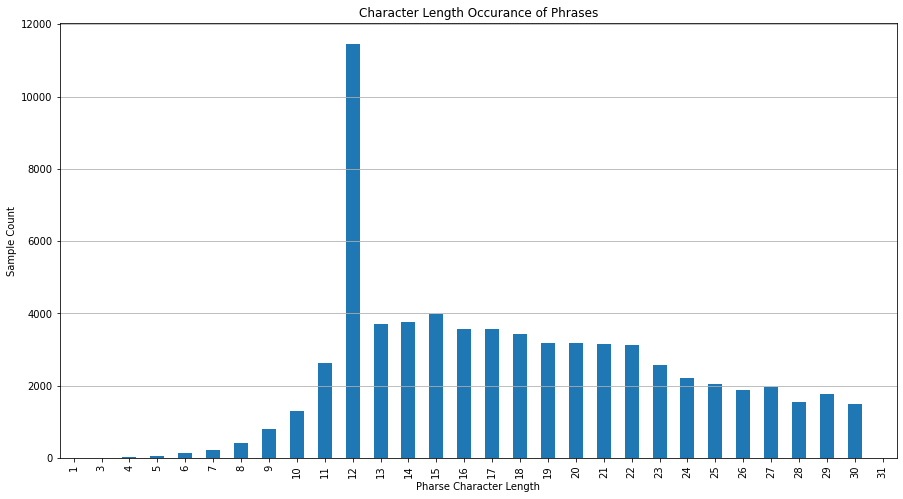

In [30]:
# Phrase Character Length Statistics
display(train_df['phrase_char_len'].describe(percentiles=PERCENTILES).to_frame().round(1))

# Character Count Occurance
plt.figure(figsize=(15,8))
plt.title('Character Length Occurance of Phrases')
train_df['phrase_char_len'].value_counts().sort_index().plot(kind='bar')
plt.xlim(-0.50, train_df['phrase_char_len'].max() - 1.50)
plt.xlabel('Pharse Character Length')
plt.ylabel('Sample Count')
plt.grid(axis='y')
plt.show()

#### Characters

In [31]:
# Use Set to keep track of unique characters in phrases
UNIQUE_CHARACTERS = set()

for phrase in tqdm(train_df['phrase_char']):
    for c in phrase:
        UNIQUE_CHARACTERS.add(c)
        
# Sorted Unique Character
UNIQUE_CHARACTERS = np.array(sorted(UNIQUE_CHARACTERS))
# Number of Unique Characters
N_UNIQUE_CHARACTERS = len(UNIQUE_CHARACTERS)
print(f'N_UNIQUE_CHARACTERS: {N_UNIQUE_CHARACTERS}')

100%|█████████████████████████████████| 67208/67208 [00:00<00:00, 688536.03it/s]

N_UNIQUE_CHARACTERS: 59


#### Keypoint videos

100%|███████████████████████████████████████████| 25/25 [00:45<00:00,  1.82s/it]


,Value
count,24966
mean,160
std,84
min,1
1%,6
5%,36
10%,66
25%,104
50%,149
75%,207


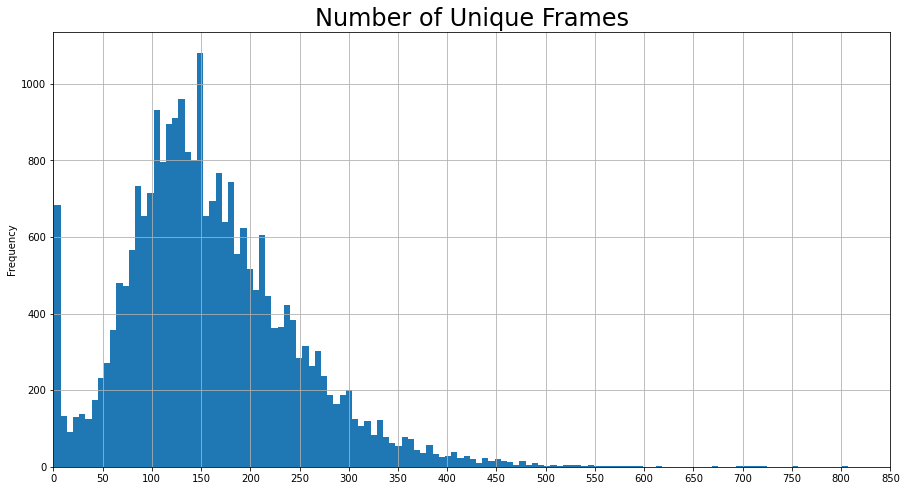

In [32]:
# Number of parquet chunks to analyse
N = 5 if IS_INTERACTIVE else 25
# Number of Unique Frames in Recording
N_UNIQUE_FRAMES = []

UNIQUE_FILE_PATHS = pd.Series(train_df['file_path'].unique())

for idx, file_path in enumerate(tqdm(UNIQUE_FILE_PATHS.sample(N, random_state=SEED))):
    df = pd.read_parquet(file_path)
    for group, group_df in df.groupby('sequence_id'):
        N_UNIQUE_FRAMES.append(group_df['frame'].nunique())

# Convert to Numpy Array
N_UNIQUE_FRAMES = np.array(N_UNIQUE_FRAMES)

# Number of unique frames in each video
display(pd.Series(N_UNIQUE_FRAMES).describe(percentiles=PERCENTILES).to_frame('Value').astype(int))

plt.figure(figsize=(15,8))
plt.title('Number of Unique Frames', size=24)
pd.Series(N_UNIQUE_FRAMES).plot(kind='hist', bins=128)
plt.grid()
xlim = math.ceil(plt.xlim()[1])
plt.xlim(0, xlim)
plt.xticks(np.arange(0, xlim+50, 50))
plt.show()

100%|█████████████████████████████████████████| 401/401 [00:14<00:00, 27.76it/s]


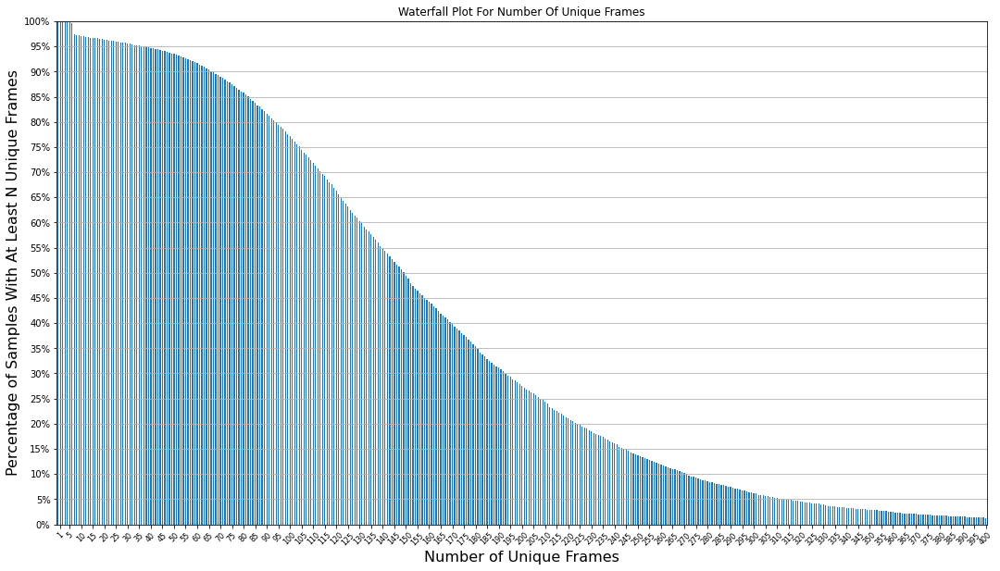

In [33]:
# With N_TARGET_FRAMES = 256 ~85% will be below
N_UNIQUE_FRAMES_WATERFALL = []
# Maximum Number of Unique Frames to use
N_MAX_UNIQUE_FRAMES = 400
# Compute Percentage
for n in tqdm(range(0,N_MAX_UNIQUE_FRAMES+1)):
    N_UNIQUE_FRAMES_WATERFALL.append(sum(N_UNIQUE_FRAMES >= n) / len(N_UNIQUE_FRAMES) * 100)

plt.figure(figsize=(18,10))
plt.title('Waterfall Plot For Number Of Unique Frames')
pd.Series(N_UNIQUE_FRAMES_WATERFALL).plot(kind='bar')
plt.grid(axis='y')
plt.xticks([1] + np.arange(5, N_MAX_UNIQUE_FRAMES+5, 5).tolist(), size=8, rotation=45)
plt.xlabel('Number of Unique Frames', size=16)
plt.yticks(np.arange(0, 100+5, 5), [f'{i}%' for i in range(0,100+5,5)])
plt.ylim(0, 100)
plt.ylabel('Percentage of Samples With At Least N Unique Frames', size=16)
plt.show()

#### Processing

In [34]:
# Lips Landmark Face Ids
LIPS_LANDMARK_IDXS = np.array([
        61, 185, 40, 39, 37, 0, 267, 269, 270, 409,
        291, 146, 91, 181, 84, 17, 314, 405, 321, 375,
        78, 191, 80, 81, 82, 13, 312, 311, 310, 415,
        95, 88, 178, 87, 14, 317, 402, 318, 324, 308,
    ])

# Landmark Indices for Left/Right hand without z axis in raw data
LEFT_HAND_IDXS0, LEFT_HAND_NAMES0 = get_idxs(sign, ['left_hand'], ['z'])
RIGHT_HAND_IDXS0, RIGHT_HAND_NAMES0 = get_idxs(sign, ['right_hand'], ['z'])
LIPS_IDXS0, LIPS_NAMES0 = get_idxs(sign, ['face'], ['z'], idxs_pos=LIPS_LANDMARK_IDXS)
COLUMNS0 = np.concatenate((LEFT_HAND_NAMES0, RIGHT_HAND_NAMES0, LIPS_NAMES0))
N_COLS0 = len(COLUMNS0)
# Only X/Y axes are used
N_DIMS0 = 2

print(f'N_COLS0: {N_COLS0}')

# Landmark Indices in subset of dataframe with only COLUMNS selected
LEFT_HAND_IDXS = np.argwhere(np.isin(COLUMNS0, LEFT_HAND_NAMES0)).squeeze()
RIGHT_HAND_IDXS = np.argwhere(np.isin(COLUMNS0, RIGHT_HAND_NAMES0)).squeeze()
LIPS_IDXS = np.argwhere(np.isin(COLUMNS0, LIPS_NAMES0)).squeeze()
N_COLS = N_COLS0
# Only X/Y axes are used
N_DIMS = 2

print(f'N_COLS: {N_COLS}')

# Indices in processed data by axes with only dominant hand
HAND_X_IDXS = np.array(
        [idx for idx, name in enumerate(LEFT_HAND_NAMES0) if 'x' in name]
    ).squeeze()
HAND_Y_IDXS = np.array(
        [idx for idx, name in enumerate(LEFT_HAND_NAMES0) if 'y' in name]
    ).squeeze()
# Names in processed data by axes
HAND_X_NAMES = LEFT_HAND_NAMES0[HAND_X_IDXS]
HAND_Y_NAMES = LEFT_HAND_NAMES0[HAND_Y_IDXS]

N_COLS0: 164
N_COLS: 164


In [35]:
"""
    Tensorflow layer to process data in TFLite
    Data needs to be processed in the model itself, so we can not use Python
""" 
class PreprocessLayerNonNaN(tf.keras.layers.Layer):
    def __init__(self):
        super(PreprocessLayerNonNaN, self).__init__()
    
    @tf.function(
        input_signature=(tf.TensorSpec(shape=[None,N_COLS0], dtype=tf.float32),),
    )
    def call(self, data0):
        # Fill NaN Values With 0
        data = tf.where(tf.math.is_nan(data0), 0.0, data0)
        
        # Hacky
        data = data[None]
        
        # Empty Hand Frame Filtering
        hands = tf.slice(data, [0,0,0], [-1, -1, 84])
        hands = tf.abs(hands)
        mask = tf.reduce_sum(hands, axis=2)
        mask = tf.not_equal(mask, 0)
        data = data[mask][None]
        data = tf.squeeze(data, axis=[0])
        
        return data

preprocess_layer_non_nan = PreprocessLayerNonNaN()

In [38]:
# Unique Parquet Files
UNIQUE_FILE_PATHS = pd.Series(train_df['file_path'].unique())
# Number of parquet chunks to analyse
N = 5 if (IS_INTERACTIVE or FAST) else len(UNIQUE_FILE_PATHS)
# Number of Non Nan Frames in Recording
N_NON_NAN_FRAMES = []

for idx, file_path in enumerate(tqdm(UNIQUE_FILE_PATHS.sample(N, random_state=SEED))):
    df = pd.read_parquet(file_path)
    for group, group_df in df.groupby('sequence_id'):
        frames = preprocess_layer_non_nan(group_df[COLUMNS0].values).numpy()
        N_NON_NAN_FRAMES.append(len(frames))

# Convert to Numpy Array
N_NON_NAN_FRAMES = pd.Series(N_NON_NAN_FRAMES).to_frame('# Frames')

100%|███████████████████████████████████████████| 68/68 [03:19<00:00,  2.93s/it]


In [41]:
"""
    Tensorflow layer to process data in TFLite
    Data needs to be processed in the model itself, so we can not use Python
""" 
class PreprocessLayer(tf.keras.layers.Layer):
    def __init__(self):
        super(PreprocessLayer, self).__init__()
    
    @tf.function(
        input_signature=(tf.TensorSpec(shape=[None,N_COLS0], dtype=tf.float32),),
    )
    def call(self, data0, resize=True):
        # Fill NaN Values With 0
        data = tf.where(tf.math.is_nan(data0), 0.0, data0)
        
        # Hacky
        data = data[None]
        
        # Empty Hand Frame Filtering
        hands = tf.slice(data, [0,0,0], [-1, -1, 84])
        hands = tf.abs(hands)
        mask = tf.reduce_sum(hands, axis=2)
        mask = tf.not_equal(mask, 0)
        data = data[mask][None]
        
        # Pad Zeros
        N_FRAMES = len(data[0])
        if N_FRAMES < N_TARGET_FRAMES:
            data = tf.concat((
                data,
                tf.zeros([1,N_TARGET_FRAMES-N_FRAMES,N_COLS], dtype=tf.float32)
            ), axis=1)
        # Downsample
        data = tf.image.resize(
            data,
            [1, N_TARGET_FRAMES],
            method=tf.image.ResizeMethod.BILINEAR,
        )
        
        # Squeeze Batch Dimension
        data = tf.squeeze(data, axis=[0])
        
        return data
    
preprocess_layer = PreprocessLayer()

inputs = group_df[COLUMNS0].values
inputs = inputs[:1]

frames = preprocess_layer(inputs)

print(f'inputs shape: {inputs.shape}')
print(f'frames shape: {frames.shape}, NaN count: {np.isnan(frames).sum()}')

inputs shape: (1, 164)
frames shape: (128, 164), NaN count: 0


In [55]:
# Read Character to Ordinal Encoding Mapping
with open('asl-fingerspelling/character_to_prediction_index.json') as json_file:
    CHAR2ORD = json.load(json_file)
display(pd.Series(CHAR2ORD).to_frame('Ordinal Encoding'))

# Number of Unique Characters
N_UNIQUE_CHARACTERS = len(CHAR2ORD)

N_UNIQUE_CHARACTERSPAD_TOKEN = len(CHAR2ORD)
SOS_TOKEN = len(CHAR2ORD) + 1 # Start Of Sentence
EOS_TOKEN = len(CHAR2ORD) + 2 # End Of Sentence

,Ordinal Encoding
,0
!,1
#,2
$,3
%,4
&,5
',6
(,7
),8
*,9


In [58]:
# Target Arrays Processed Input Videos
X = np.zeros([N_SAMPLES, N_TARGET_FRAMES, N_COLS], dtype=np.float32)
# Ordinally Encoded Target With value 59 for pad token
y = np.full(shape=[N_SAMPLES, N_TARGET_FRAMES], fill_value=N_UNIQUE_CHARACTERS, dtype=np.int8)
# Phrase Type
y_phrase_type = np.empty(shape=[N_SAMPLES], dtype=object)

# All Unique Parquet Files
UNIQUE_FILE_PATHS = pd.Series(train_df['file_path'].unique())
N_UNIQUE_FILE_PATHS = len(UNIQUE_FILE_PATHS)
# Counter to keep track of sample
row = 0
count = 0
# Compressed Parquet Files
Path('train_landmark_subsets').mkdir(parents=True, exist_ok=True)
# Numbre Of Frames Per Character
N_FRAMES_PER_CHARACTER = []
# Minimum Number Of Frames Per Character
MIN_NUM_FRAMES_PER_CHARACTER = 4
VALID_IDXS = []

# Fill Arrays
for idx, file_path in enumerate(tqdm(UNIQUE_FILE_PATHS)):
    # Progress Logging
    print(f'Processed {idx:02d}/{N_UNIQUE_FILE_PATHS} parquet files')
    # Read parquet file
    df = pd.read_parquet(file_path)
    # Save COLUMN Subset of parquet files for TFLite Model verficiation
    name = file_path.split('/')[-1]
    if idx < 10:
        df[COLUMNS0].to_parquet(f'train_landmark_subsets/{name}', engine='pyarrow', compression='zstd')
    # Iterate Over Samples
    for group, group_df in df.groupby('sequence_id'):
        # Number of Frames Per Character
        n_frames_per_character =  len(group_df[COLUMNS0].values) / len(train_sequence_id.loc[group, 'phrase_char'])
        N_FRAMES_PER_CHARACTER.append(n_frames_per_character)
        if n_frames_per_character < MIN_NUM_FRAMES_PER_CHARACTER:
            count = count + 1
            continue
        else:
            # Add Valid Index
            VALID_IDXS.append(count)
            count = count + 1
        
        # Get Processed Frames and non empty frame indices
        frames = preprocess_layer(group_df[COLUMNS0].values)
        assert frames.ndim == 2
        # Assign
        X[row] = frames
        # Add Target By Ordinally Encoding Characters
        phrase_char = train_sequence_id.loc[group, 'phrase_char']
        for col, char in enumerate(phrase_char):
            y[row, col] = CHAR2ORD.get(char)
        # Add EOS Token
        y[row, col+1] = EOS_TOKEN
        # Phrase Type
        y_phrase_type[row] = train_sequence_id.loc[group, 'phrase_type']
        # Row Count
        row += 1
    # clean up
    gc.collect()

  0%|                                                    | 0/68 [00:00<?, ?it/s]

Processed 00/68 parquet files


  1%|▋                                           | 1/68 [00:04<05:09,  4.61s/it]

Processed 01/68 parquet files


  3%|█▎                                          | 2/68 [00:09<05:19,  4.84s/it]

Processed 02/68 parquet files


  4%|█▉                                          | 3/68 [00:14<05:13,  4.83s/it]

Processed 03/68 parquet files


  6%|██▌                                         | 4/68 [00:19<05:18,  4.97s/it]

Processed 04/68 parquet files


  7%|███▏                                        | 5/68 [00:25<05:22,  5.13s/it]

Processed 05/68 parquet files


  9%|███▉                                        | 6/68 [00:30<05:17,  5.12s/it]

Processed 06/68 parquet files


 10%|████▌                                       | 7/68 [00:34<05:06,  5.02s/it]

Processed 07/68 parquet files


 12%|█████▏                                      | 8/68 [00:40<05:07,  5.12s/it]

Processed 08/68 parquet files


 13%|█████▊                                      | 9/68 [00:45<05:05,  5.17s/it]

Processed 09/68 parquet files


 15%|██████▎                                    | 10/68 [00:50<04:56,  5.10s/it]

Processed 10/68 parquet files


 16%|██████▉                                    | 11/68 [00:53<04:21,  4.59s/it]

Processed 11/68 parquet files


 18%|███████▌                                   | 12/68 [00:57<03:58,  4.26s/it]

Processed 12/68 parquet files


 19%|████████▏                                  | 13/68 [01:00<03:39,  3.99s/it]

Processed 13/68 parquet files


 21%|████████▊                                  | 14/68 [01:01<02:45,  3.07s/it]

Processed 14/68 parquet files


 22%|█████████▍                                 | 15/68 [01:05<02:48,  3.18s/it]

Processed 15/68 parquet files


 24%|██████████                                 | 16/68 [01:08<02:49,  3.27s/it]

Processed 16/68 parquet files


 25%|██████████▊                                | 17/68 [01:12<02:50,  3.35s/it]

Processed 17/68 parquet files


 26%|███████████▍                               | 18/68 [01:15<02:50,  3.42s/it]

Processed 18/68 parquet files


 28%|████████████                               | 19/68 [01:19<02:46,  3.40s/it]

Processed 19/68 parquet files


 29%|████████████▋                              | 20/68 [01:22<02:43,  3.40s/it]

Processed 20/68 parquet files


 31%|█████████████▎                             | 21/68 [01:26<02:43,  3.47s/it]

Processed 21/68 parquet files


 32%|█████████████▉                             | 22/68 [01:29<02:39,  3.47s/it]

Processed 22/68 parquet files


 34%|██████████████▌                            | 23/68 [01:33<02:36,  3.47s/it]

Processed 23/68 parquet files


 35%|███████████████▏                           | 24/68 [01:36<02:32,  3.47s/it]

Processed 24/68 parquet files


 37%|███████████████▊                           | 25/68 [01:39<02:28,  3.45s/it]

Processed 25/68 parquet files


 38%|████████████████▍                          | 26/68 [01:43<02:26,  3.48s/it]

Processed 26/68 parquet files


 40%|█████████████████                          | 27/68 [01:47<02:23,  3.50s/it]

Processed 27/68 parquet files


 41%|█████████████████▋                         | 28/68 [01:50<02:19,  3.50s/it]

Processed 28/68 parquet files


 43%|██████████████████▎                        | 29/68 [01:54<02:16,  3.50s/it]

Processed 29/68 parquet files


 44%|██████████████████▉                        | 30/68 [01:57<02:16,  3.58s/it]

Processed 30/68 parquet files


 46%|███████████████████▌                       | 31/68 [02:01<02:11,  3.55s/it]

Processed 31/68 parquet files


 47%|████████████████████▏                      | 32/68 [02:04<02:06,  3.53s/it]

Processed 32/68 parquet files


 49%|████████████████████▊                      | 33/68 [02:08<02:03,  3.53s/it]

Processed 33/68 parquet files


 50%|█████████████████████▌                     | 34/68 [02:12<02:03,  3.62s/it]

Processed 34/68 parquet files


 51%|██████████████████████▏                    | 35/68 [02:16<02:05,  3.79s/it]

Processed 35/68 parquet files


 53%|██████████████████████▊                    | 36/68 [02:19<01:58,  3.72s/it]

Processed 36/68 parquet files


 54%|███████████████████████▍                   | 37/68 [02:23<01:55,  3.73s/it]

Processed 37/68 parquet files


 56%|████████████████████████                   | 38/68 [02:27<01:52,  3.73s/it]

Processed 38/68 parquet files


 57%|████████████████████████▋                  | 39/68 [02:30<01:45,  3.64s/it]

Processed 39/68 parquet files


 59%|█████████████████████████▎                 | 40/68 [02:34<01:41,  3.64s/it]

Processed 40/68 parquet files


 60%|█████████████████████████▉                 | 41/68 [02:38<01:39,  3.70s/it]

Processed 41/68 parquet files


 62%|██████████████████████████▌                | 42/68 [02:42<01:36,  3.71s/it]

Processed 42/68 parquet files


 63%|███████████████████████████▏               | 43/68 [02:45<01:31,  3.66s/it]

Processed 43/68 parquet files


 65%|███████████████████████████▊               | 44/68 [02:49<01:27,  3.63s/it]

Processed 44/68 parquet files


 66%|████████████████████████████▍              | 45/68 [02:52<01:23,  3.63s/it]

Processed 45/68 parquet files


 68%|█████████████████████████████              | 46/68 [02:56<01:20,  3.66s/it]

Processed 46/68 parquet files


 69%|█████████████████████████████▋             | 47/68 [03:00<01:17,  3.70s/it]

Processed 47/68 parquet files


 71%|██████████████████████████████▎            | 48/68 [03:04<01:14,  3.74s/it]

Processed 48/68 parquet files


 72%|██████████████████████████████▉            | 49/68 [03:08<01:12,  3.80s/it]

Processed 49/68 parquet files


 74%|███████████████████████████████▌           | 50/68 [03:11<01:08,  3.78s/it]

Processed 50/68 parquet files


 75%|████████████████████████████████▎          | 51/68 [03:15<01:04,  3.77s/it]

Processed 51/68 parquet files


 76%|████████████████████████████████▉          | 52/68 [03:19<00:59,  3.74s/it]

Processed 52/68 parquet files


 78%|█████████████████████████████████▌         | 53/68 [03:23<00:56,  3.78s/it]

Processed 53/68 parquet files


 79%|██████████████████████████████████▏        | 54/68 [03:27<00:53,  3.84s/it]

Processed 54/68 parquet files


 81%|██████████████████████████████████▊        | 55/68 [03:30<00:49,  3.81s/it]

Processed 55/68 parquet files


 82%|███████████████████████████████████▍       | 56/68 [03:34<00:45,  3.78s/it]

Processed 56/68 parquet files


 84%|████████████████████████████████████       | 57/68 [03:38<00:42,  3.84s/it]

Processed 57/68 parquet files


 85%|████████████████████████████████████▋      | 58/68 [03:42<00:38,  3.82s/it]

Processed 58/68 parquet files


 87%|█████████████████████████████████████▎     | 59/68 [03:46<00:34,  3.84s/it]

Processed 59/68 parquet files


 88%|█████████████████████████████████████▉     | 60/68 [03:50<00:31,  3.93s/it]

Processed 60/68 parquet files


 90%|██████████████████████████████████████▌    | 61/68 [03:54<00:27,  3.99s/it]

Processed 61/68 parquet files


 91%|███████████████████████████████████████▏   | 62/68 [03:58<00:23,  3.98s/it]

Processed 62/68 parquet files


 93%|███████████████████████████████████████▊   | 63/68 [04:02<00:19,  3.88s/it]

Processed 63/68 parquet files


 94%|████████████████████████████████████████▍  | 64/68 [04:05<00:15,  3.83s/it]

Processed 64/68 parquet files


 96%|█████████████████████████████████████████  | 65/68 [04:09<00:11,  3.72s/it]

Processed 65/68 parquet files


 97%|█████████████████████████████████████████▋ | 66/68 [04:12<00:07,  3.68s/it]

Processed 66/68 parquet files


 99%|██████████████████████████████████████████▎| 67/68 [04:16<00:03,  3.71s/it]

Processed 67/68 parquet files


100%|███████████████████████████████████████████| 68/68 [04:20<00:00,  3.83s/it]


In [59]:
# rows denotes the number of samples with frames/character above threshold
print(f'row: {row}, count: {count}')

# Example target, note the phrase is padded with the pad token 59
print(f'Example Target: {y[0]}')

row: 61955, count: 67208
Example Target: [18  0 34 49 36 36 42 39 46 52 50 36 61 59 59 59 59 59 59 59 59 59 59 59
 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59
 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59
 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59
 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59 59
 59 59 59 59 59 59 59 59]


In [63]:
# Filer X/y
X = X[:row]
y = y[:row]

# Save X/y
np.save('X.npy', X)
np.save('y.npy', y)
# Save Validation
splitter = GroupShuffleSplit(test_size=0.10, n_splits=2, random_state=SEED)
PARTICIPANT_IDS = train_df['participant_id'].values[VALID_IDXS]
train_idxs, val_idxs = next(splitter.split(X, y, groups=PARTICIPANT_IDS))

# Save Train
np.save('X_train.npy', X[train_idxs])
np.save('y_train.npy', y[train_idxs])
# Save Validation
np.save('X_val.npy', X[val_idxs])
np.save('y_val.npy', y[val_idxs])
# Verify Train/Val is correctly split by participan id
print(f'Patient ID Intersection Train/Val: {set(PARTICIPANT_IDS[train_idxs]).intersection(PARTICIPANT_IDS[val_idxs])}')
# Train/Val Sizes
print(f'# Train Samples: {len(train_idxs)}, # Val Samples: {len(val_idxs)}')

Patient ID Intersection Train/Val: set()
# Train Samples: 54719, # Val Samples: 7236


#### Character stats

,Value
count,67208.00
mean,9.02
std,3.84
min,0.03
1%,0.33
5%,2.38
10%,4.62
25%,6.75
50%,8.86
75%,11.18


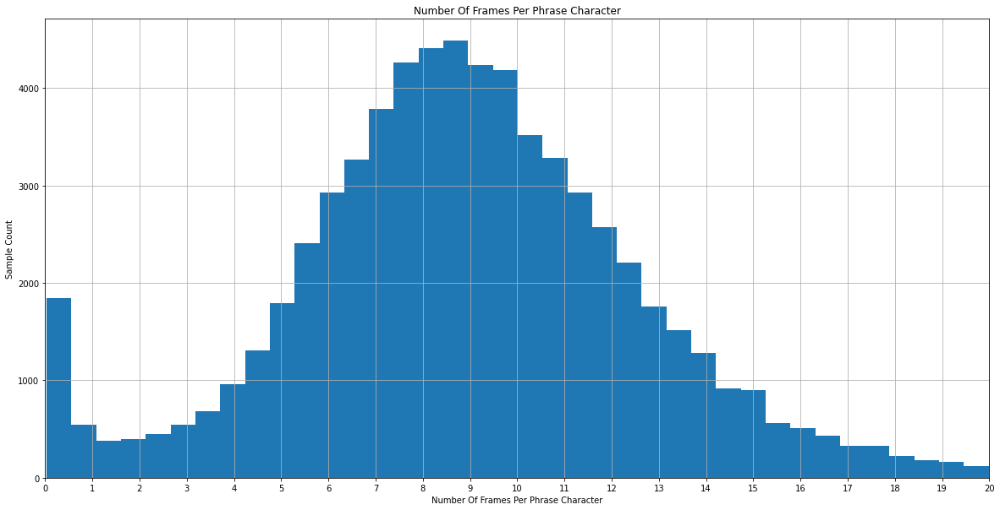

In [65]:
N_FRAMES_PER_CHARACTER_S = pd.Series(N_FRAMES_PER_CHARACTER)

display(N_FRAMES_PER_CHARACTER_S.describe(percentiles=PERCENTILES).to_frame('Value').round(2))

plt.figure(figsize=(20,10))
plt.title('Number Of Frames Per Phrase Character')
N_FRAMES_PER_CHARACTER_S.plot(kind='hist', bins=128)
# Plot till 99th percentile
p99 = math.ceil(np.percentile(N_FRAMES_PER_CHARACTER_S, 99))
plt.xticks(np.arange(0, p99+1, 1))
plt.xlim(0, p99)
plt.xlabel('Number Of Frames Per Phrase Character')
plt.ylabel('Sample Count')
plt.grid()
plt.show()

#### Coordinates stats

100%|█████████████████████████████████████████| 164/164 [00:43<00:00,  3.75it/s]


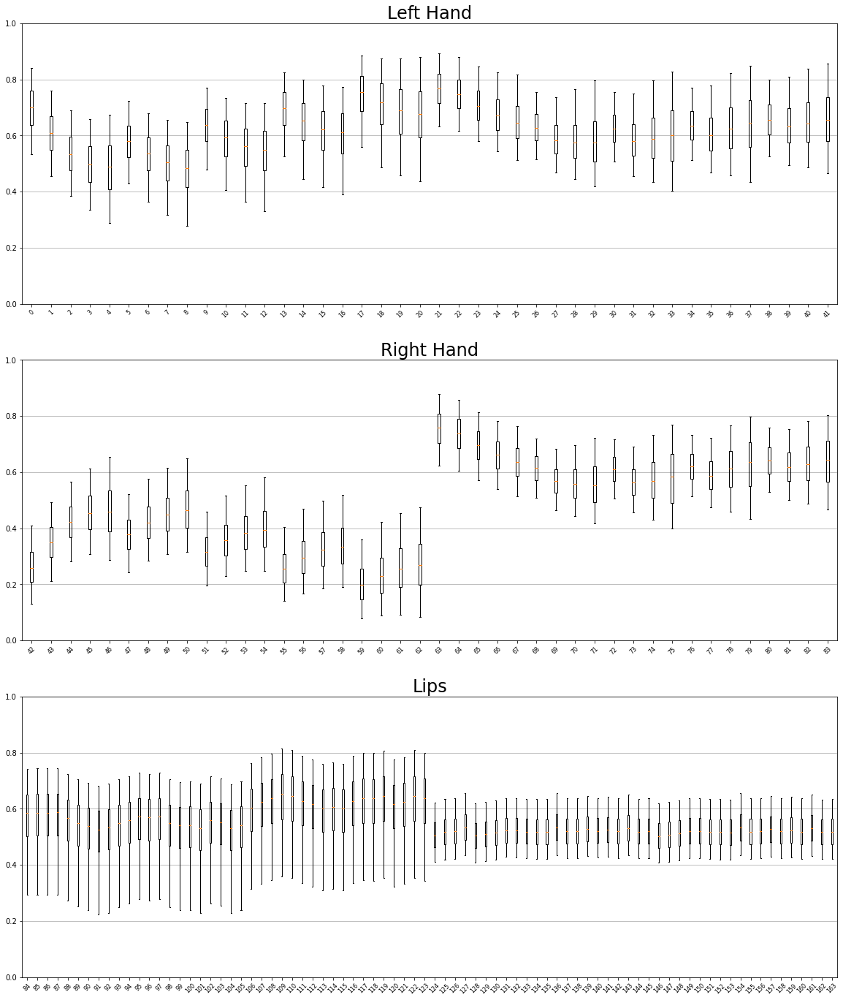

In [66]:
def get_left_right_hand_mean_std():
    # Dominant Hand Statistics
    MEANS = np.zeros([N_COLS], dtype=np.float32)
    STDS = np.zeros([N_COLS], dtype=np.float32)
    
    # Plot
    fig, axes = plt.subplots(3, figsize=(20, 3*8))
    
    # Iterate over all landmarks
    for col, v in enumerate(tqdm(X.reshape([-1, N_COLS]).T)):
        v = v[np.nonzero(v)]
        # Remove zero values as they are NaN values
        MEANS[col] = v.astype(np.float32).mean()
        STDS[col] = v.astype(np.float32).std()
        if col in LEFT_HAND_IDXS:
            axes[0].boxplot(v, notch=False, showfliers=False, positions=[col], whis=[5,95])
        elif col in RIGHT_HAND_IDXS:
            axes[1].boxplot(v, notch=False, showfliers=False, positions=[col], whis=[5,95])
        else:
            axes[2].boxplot(v, notch=False, showfliers=False, positions=[col], whis=[5,95])
        
    for ax, name in zip(axes, ['Left Hand', 'Right Hand', 'Lips']):
        ax.set_title(f'{name}', size=24)
        ax.tick_params(axis='x', labelsize=8, rotation=45)
        ax.set_ylim(0.0, 1.0)
        ax.grid(axis='y')

    plt.show()
    
    return MEANS, STDS

# Get Dominant Hand Mean/Standard Deviation
MEANS, STDS = get_left_right_hand_mean_std()
# Save Mean/STD to normalize input in neural network model
np.save('MEANS.npy', MEANS)
np.save('STDS.npy', STDS)